# start

In [7]:
PRFX = 'MelEda0627A1'
PRFX_PREP = 'MelPrp0626A2'

# setup

In [43]:
from pathlib import Path
import pickle
import pandas as pd
import random
import os
import numpy as np
import matplotlib.pyplot as plt

from collections import defaultdict, Counter

# eda

In [24]:
p_cmp = '../input/siim-isic-melanoma-classification/'
p_prp = f'../output/{PRFX_PREP}'
dftrn = pd.read_csv(f'{p_prp}/train_all.csv') 
dftst = pd.read_csv(f'{p_cmp}/test.csv')

In [10]:
dftrn.shape

(58457, 4)

In [25]:
dftst.shape

(10982, 5)

In [11]:
dftrn.head()

,source,im_pth,patient_id,target
0,20,../input/siim-isic-melanoma-classification/jpe...,IP_7279968,0.0
1,20,../input/siim-isic-melanoma-classification/jpe...,IP_3075186,0.0
2,20,../input/siim-isic-melanoma-classification/jpe...,IP_2842074,0.0
3,20,../input/siim-isic-melanoma-classification/jpe...,IP_6890425,0.0
4,20,../input/siim-isic-melanoma-classification/jpe...,IP_8723313,0.0


In [26]:
dftst.head()

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge
0,ISIC_0052060,IP_3579794,male,70.0,NaN
1,ISIC_0052349,IP_7782715,male,40.0,lower extremity
2,ISIC_0058510,IP_7960270,female,55.0,torso
3,ISIC_0073313,IP_6375035,female,50.0,torso
4,ISIC_0073502,IP_0589375,female,45.0,lower extremity


## train set imgs

In [34]:
idx_nopid=np.where(dftrn.patient_id.isna())[0]
print(len(idx_nopid))
dftrn['patient_id'].iloc[idx_nopid]=[f'Nan_{i}' for i in range(len(idx_nopid))]
assert dftrn.patient_id.isna().mean()==0

0


- A part of the training dataset is the HAM10 0 0 0 dataset which contains images of size 600 ×450 that were centered and cropped around the lesion. 
- The dataset curators applied histogram corrections to some images [1] . 
- Another dataset, BCN_20 0 0 0, contains images of size 1024 ×1024. This dataset is particularly challenging as many images are uncropped and lesions in difficult and uncommon locations are present [2] . 
- Last, the MSK dataset contains images with various sizes.

In [35]:
dftrn['ds']=dftrn.patient_id.apply(lambda x: x.split('_')[0])
dftrn.ds.value_counts()

IP      33126
BCN     12413
HAM     10015
Nan      2084
MSK4      819
Name: ds, dtype: int64

In [37]:
dftrn.sample()

,source,im_pth,patient_id,target,ds
51787,19,../input/andrewmvd--isic-2019/ISIC_2019_Traini...,BCN_0002603,0.0,BCN


In [38]:
dftrn.groupby('ds').target.mean()

ds
BCN     0.230162
HAM     0.111133
IP      0.017630
MSK4    0.262515
Nan     0.161708
Name: target, dtype: float64

IP
../input/siim-isic-melanoma-classification/jpeg/train/ISIC_8704672.jpg


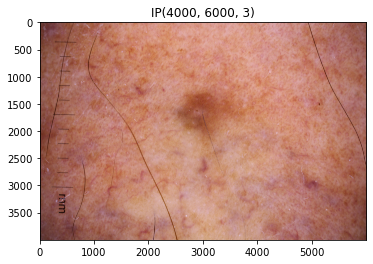

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_7796821.jpg


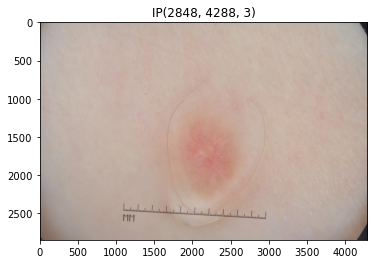

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_6905623.jpg


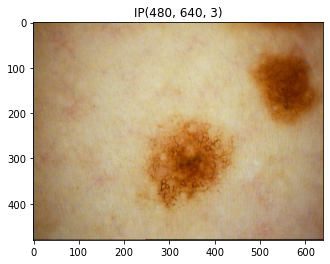

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_9203424.jpg


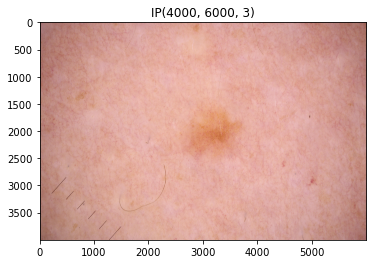

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_7920605.jpg


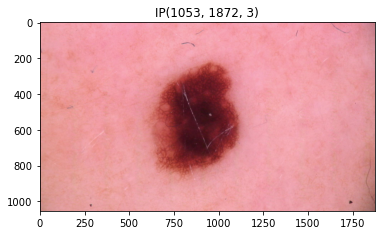

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_0902830.jpg


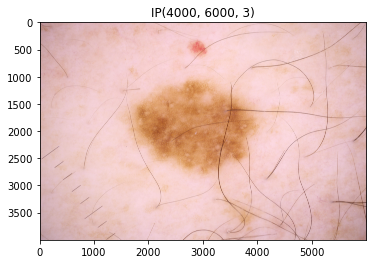

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_6097644.jpg


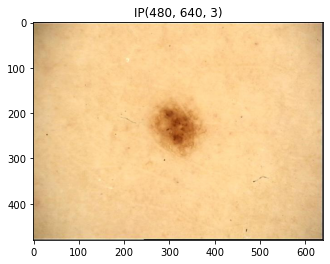

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_1095325.jpg


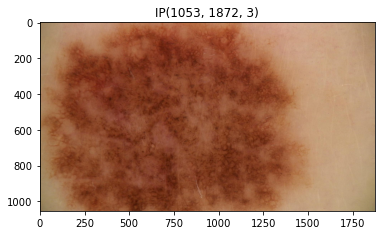

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_2445235.jpg


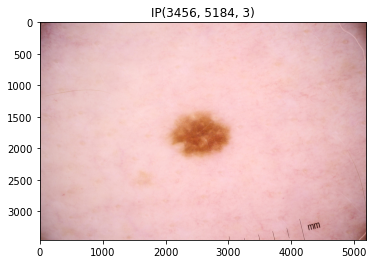

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_0552911.jpg


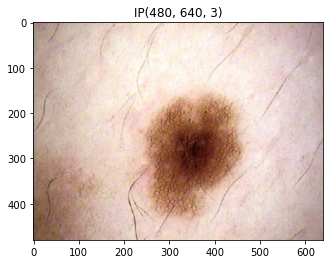

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_9692222.jpg


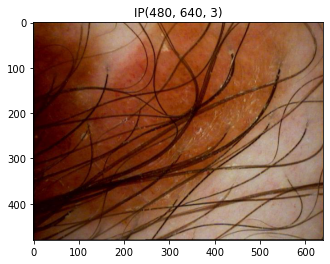

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_9564900.jpg


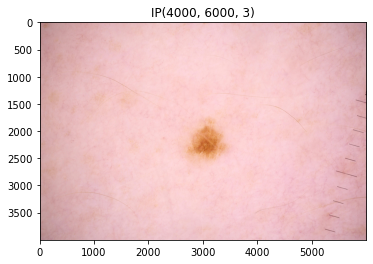

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_0234049.jpg


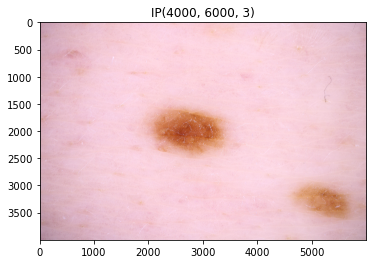

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_5097807.jpg


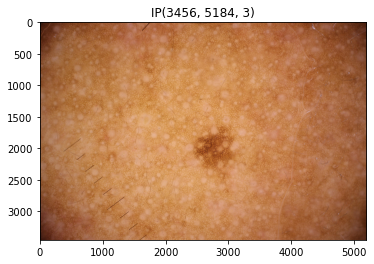

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_9263944.jpg


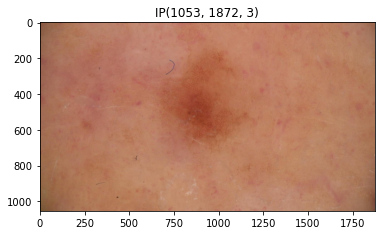

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_9722385.jpg


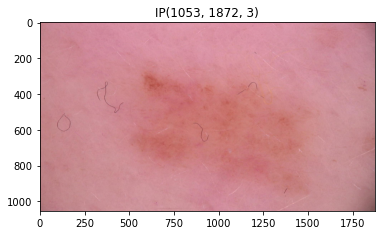

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_5300455.jpg


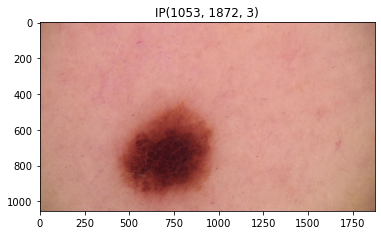

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_8535451.jpg


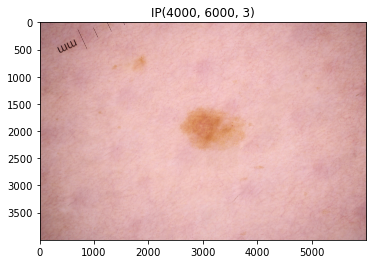

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_5388485.jpg


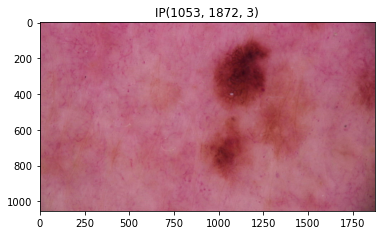

../input/siim-isic-melanoma-classification/jpeg/train/ISIC_9223481.jpg


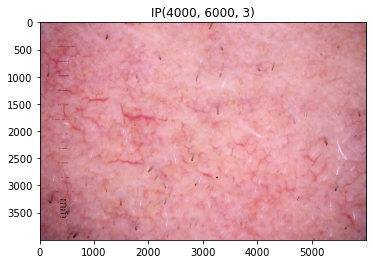

**************************************************
Nan
../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0010441.jpg


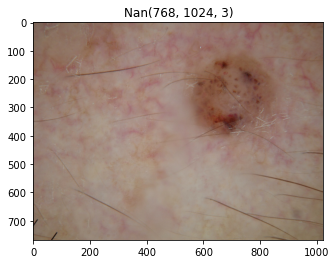

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0000140_downsampled.jpg


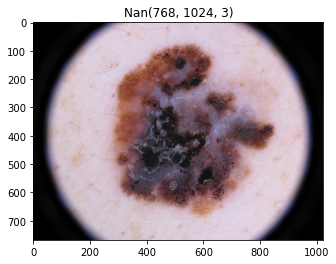

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0000486.jpg


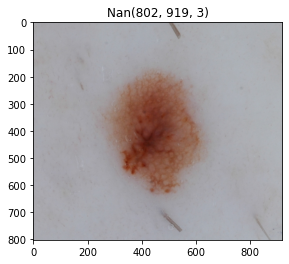

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0015417_downsampled.jpg


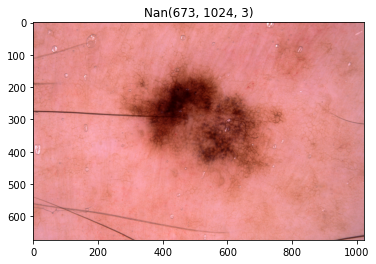

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0000142_downsampled.jpg


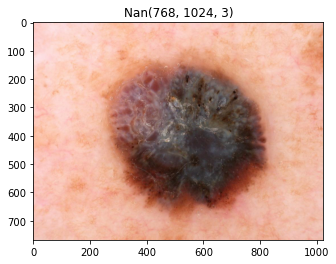

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0015041_downsampled.jpg


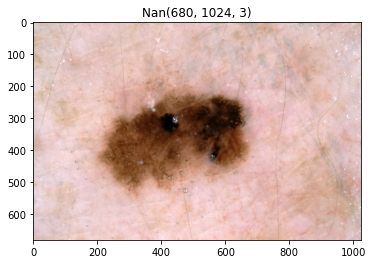

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0000481.jpg


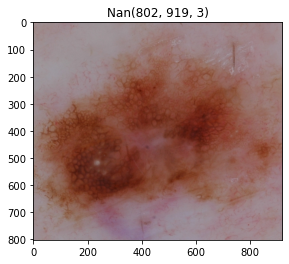

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0010605.jpg


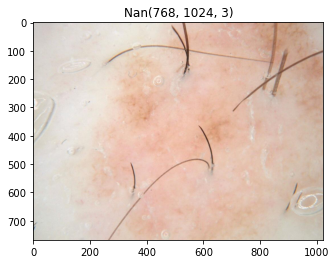

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0014938_downsampled.jpg


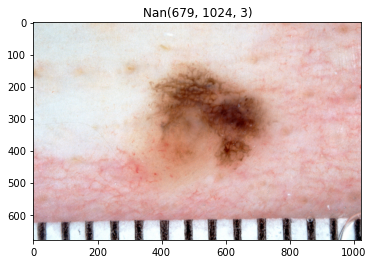

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0014642_downsampled.jpg


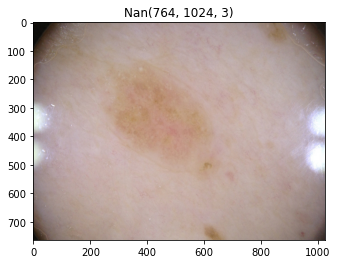

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0002806_downsampled.jpg


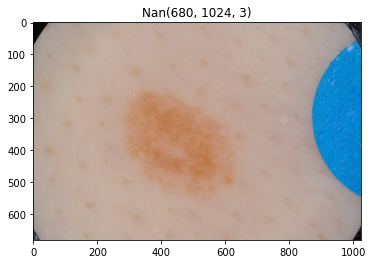

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0008785_downsampled.jpg


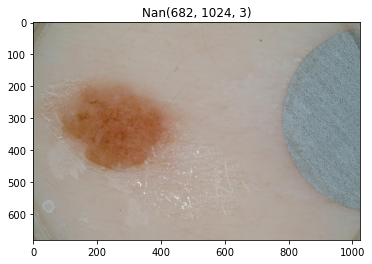

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0014860_downsampled.jpg


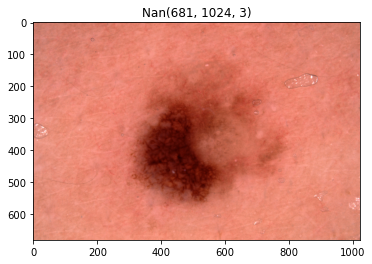

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0000487.jpg


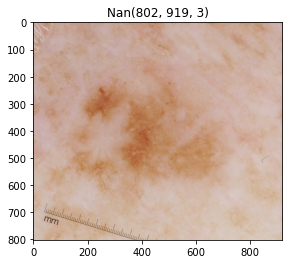

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0012260_downsampled.jpg


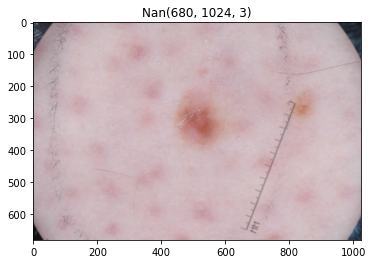

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0009960.jpg


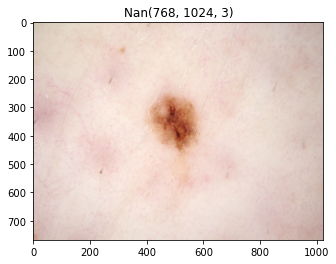

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0000516.jpg


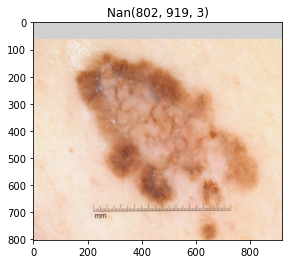

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0009933.jpg


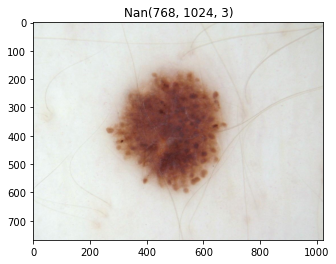

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0008807_downsampled.jpg


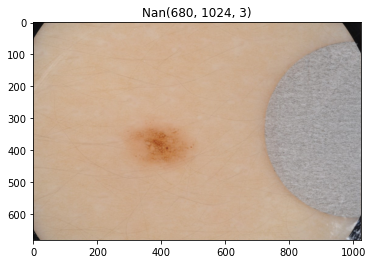

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0015013_downsampled.jpg


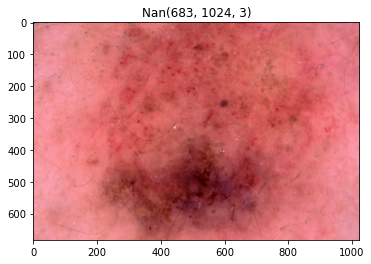

**************************************************
MSK4
../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013124_downsampled.jpg


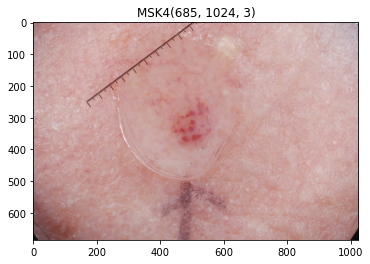

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013096_downsampled.jpg


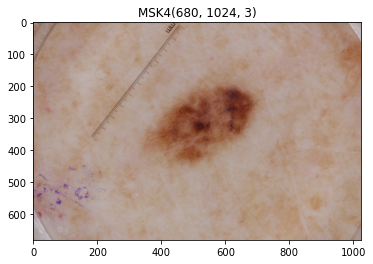

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013207_downsampled.jpg


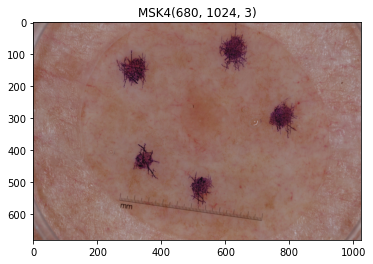

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013600_downsampled.jpg


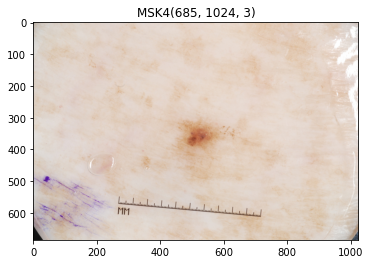

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0014249_downsampled.jpg


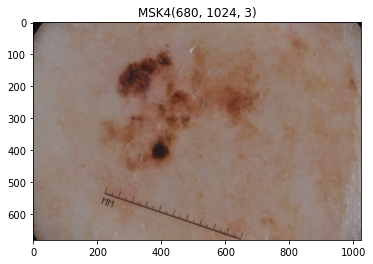

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013232_downsampled.jpg


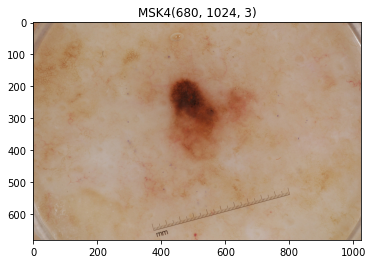

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0014069_downsampled.jpg


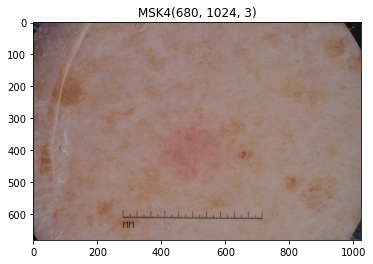

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013958_downsampled.jpg


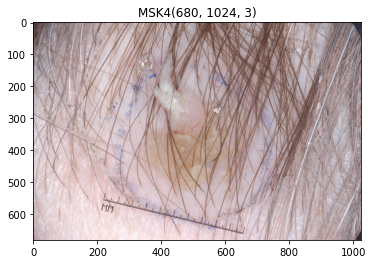

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0012837_downsampled.jpg


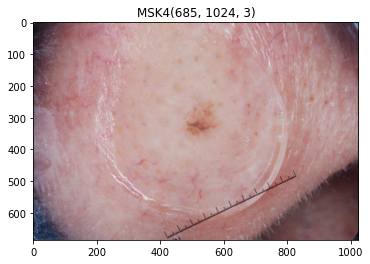

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013026_downsampled.jpg


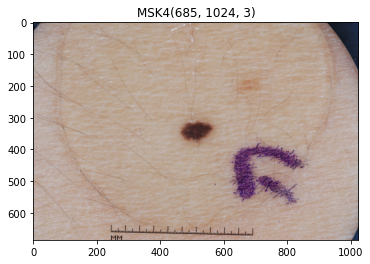

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0014027_downsampled.jpg


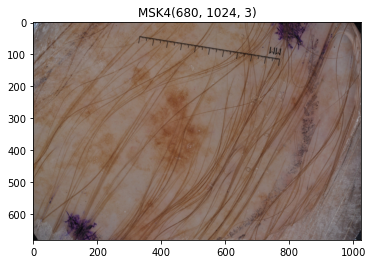

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0014038_downsampled.jpg


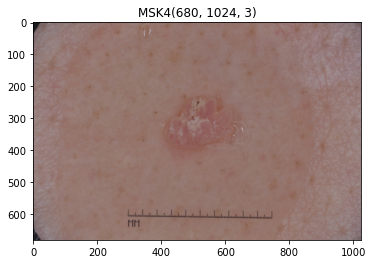

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013588_downsampled.jpg


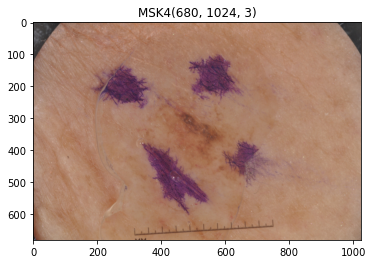

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013224_downsampled.jpg


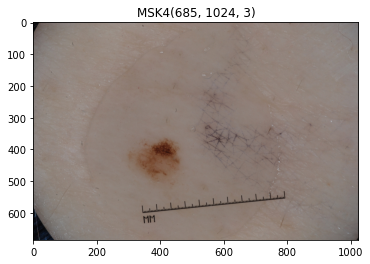

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013795_downsampled.jpg


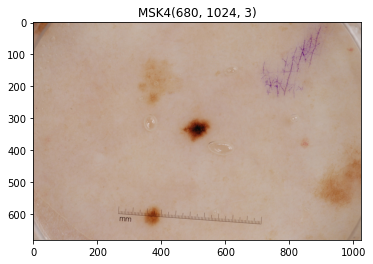

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013719_downsampled.jpg


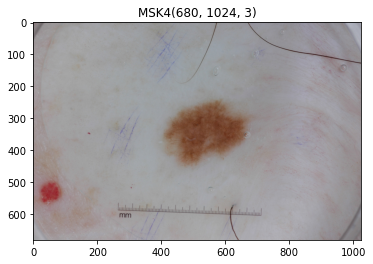

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013809_downsampled.jpg


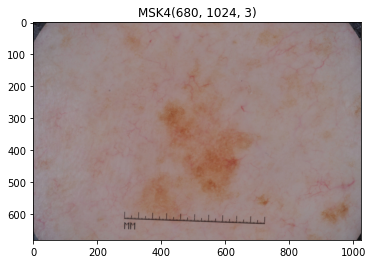

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0012891_downsampled.jpg


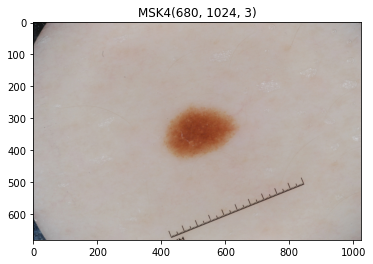

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013071_downsampled.jpg


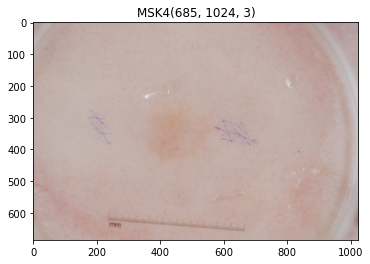

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0013578_downsampled.jpg


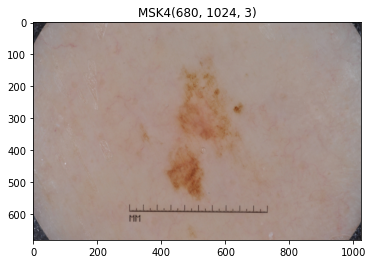

**************************************************
HAM
../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0029310.jpg


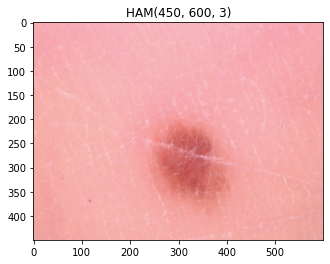

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0029510.jpg


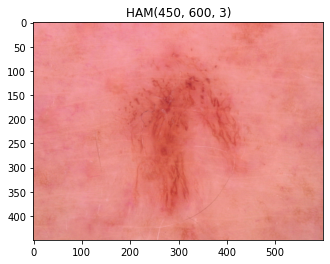

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0030139.jpg


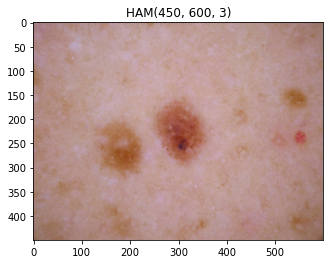

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0034168.jpg


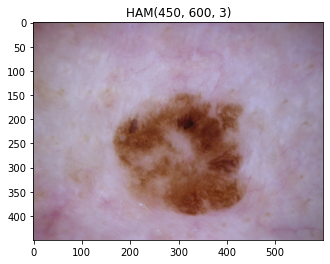

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0033349.jpg


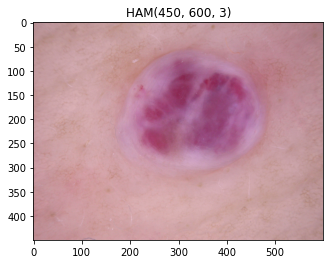

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0032199.jpg


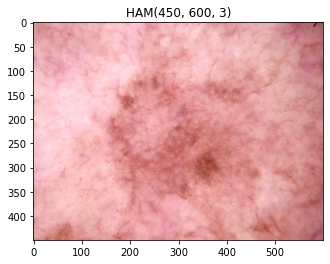

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0025921.jpg


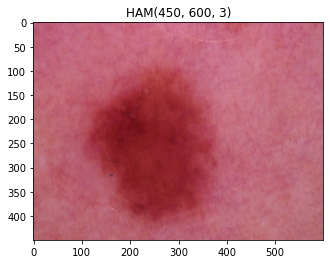

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0031237.jpg


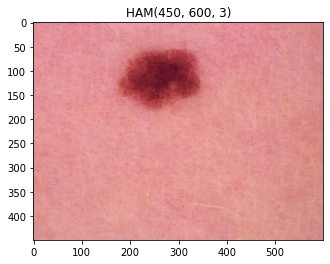

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0025458.jpg


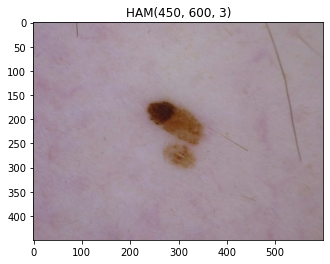

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0032110.jpg


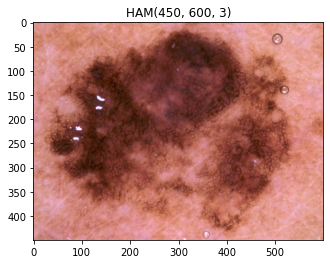

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0029892.jpg


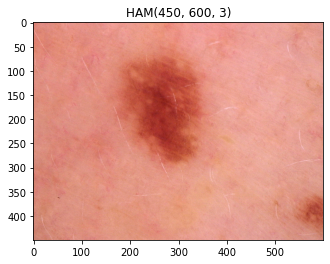

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0032958.jpg


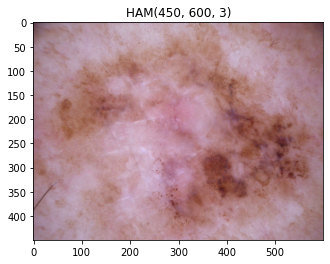

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0024310.jpg


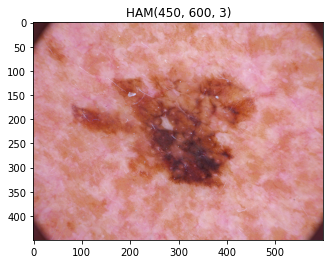

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0025092.jpg


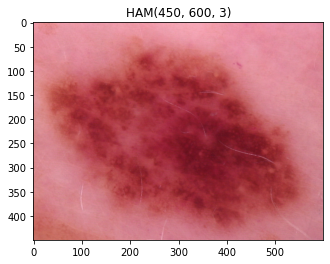

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0030225.jpg


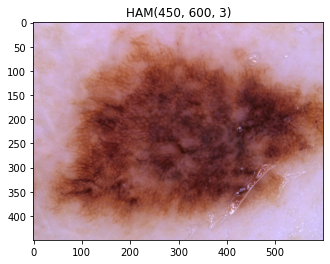

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0030104.jpg


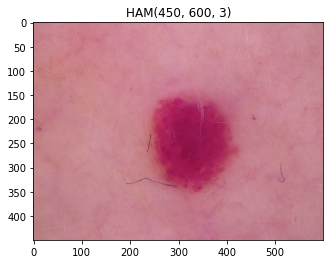

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0029341.jpg


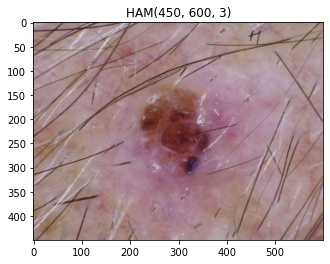

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0033415.jpg


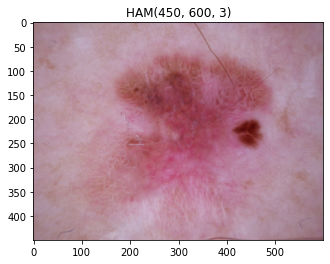

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0024379.jpg


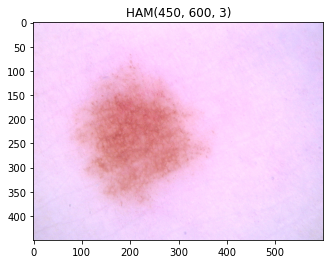

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0026755.jpg


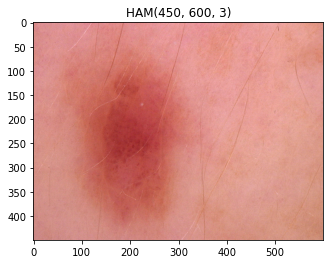

**************************************************
BCN
../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0060594.jpg


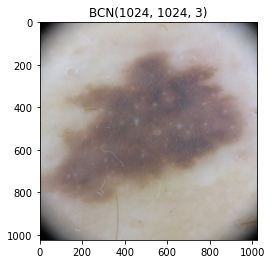

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0072755.jpg


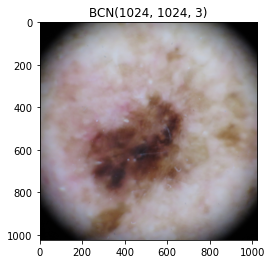

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0063583.jpg


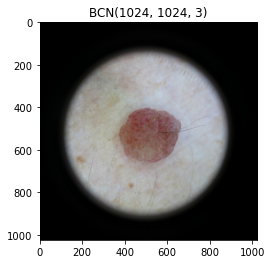

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0071893.jpg


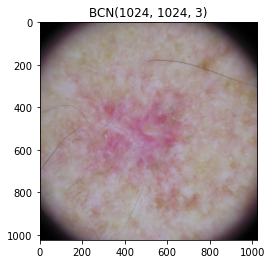

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0061354.jpg


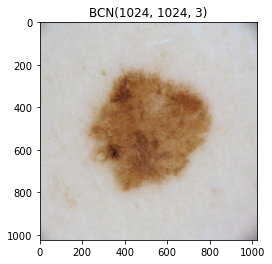

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0073039.jpg


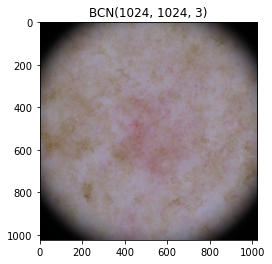

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0072891.jpg


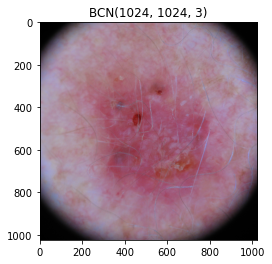

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0066349.jpg


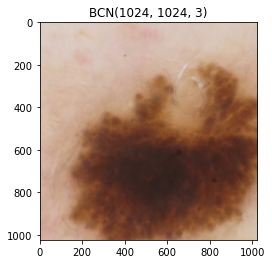

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0061643.jpg


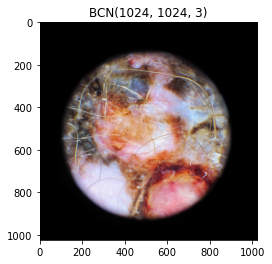

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0058543.jpg


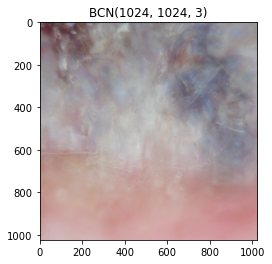

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0061581.jpg


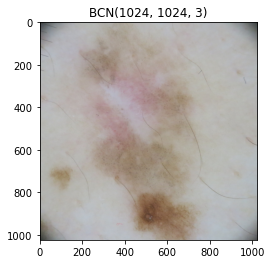

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0062187.jpg


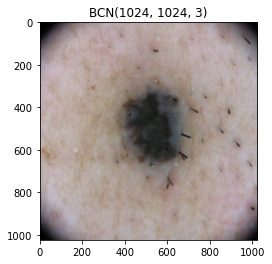

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0062196.jpg


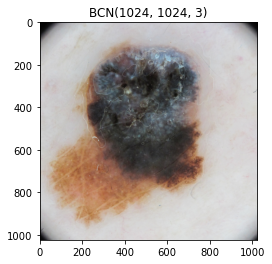

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0055626.jpg


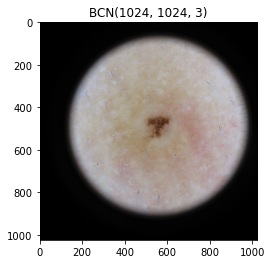

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0056128.jpg


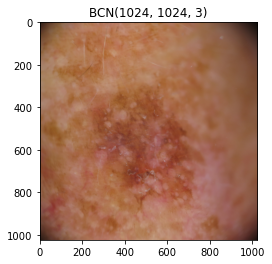

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0069970.jpg


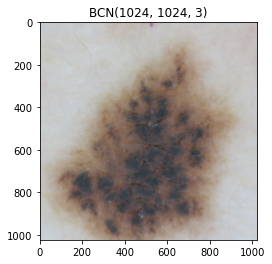

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0065493.jpg


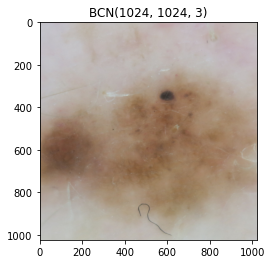

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0068953.jpg


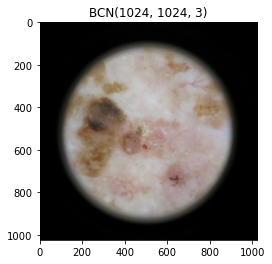

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0067044.jpg


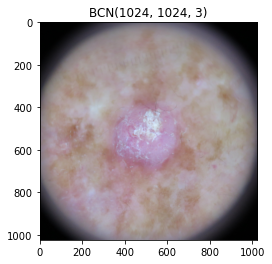

../input/andrewmvd--isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input/ISIC_0056583.jpg


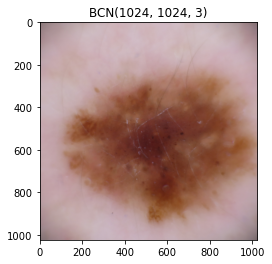

**************************************************


In [62]:
dss = dftrn.ds.unique()

for ds in dss:
    print(ds)
    fnms = np.random.choice(dftrn[dftrn.ds==ds].im_pth, 20, replace=False)
    for fnm in fnms:
        print(fnm)
        img = plt.imread(fnm)
        plt.title(f'{ds}{img.shape}')
        plt.imshow(img)
        plt.show()
    print('*'*50)

## test set imgs

In [63]:
dftst['im_pth']=f'{p_cmp}/jpeg/test/'+dftst.image_name+'.jpg'

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_8900885.jpg


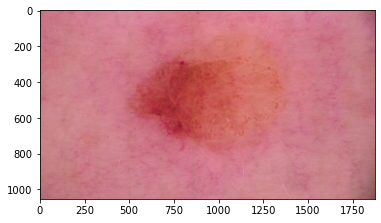

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_4797111.jpg


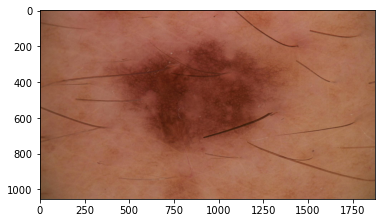

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_1415022.jpg


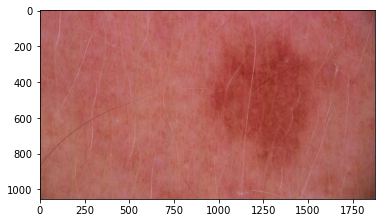

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_0436884.jpg


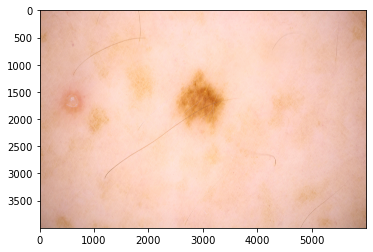

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_1178339.jpg


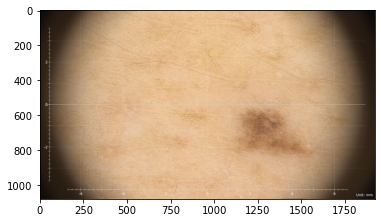

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_3832497.jpg


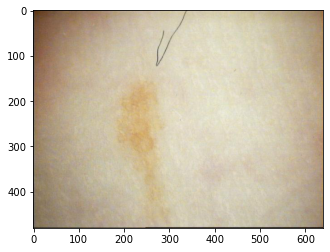

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_1241336.jpg


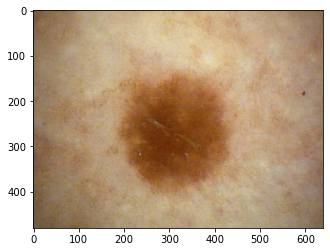

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_1643383.jpg


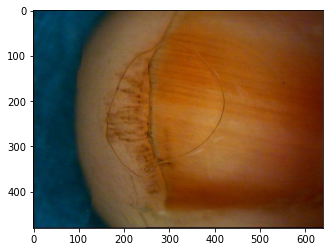

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_6000877.jpg


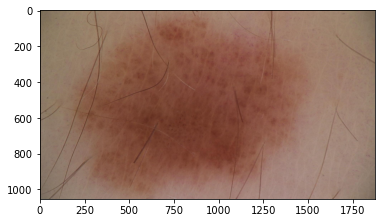

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_9660608.jpg


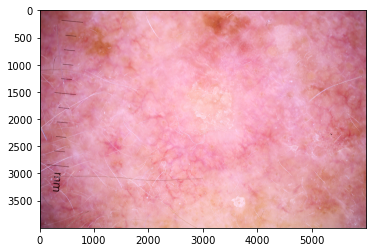

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_2378781.jpg


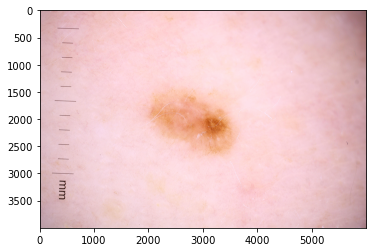

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_5774467.jpg


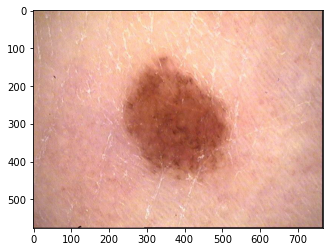

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_5815409.jpg


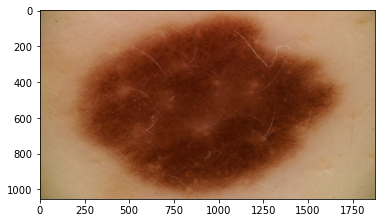

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_9515324.jpg


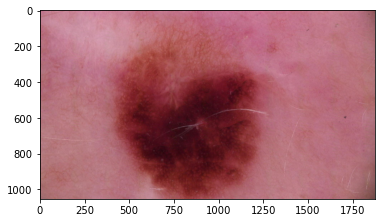

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_3716403.jpg


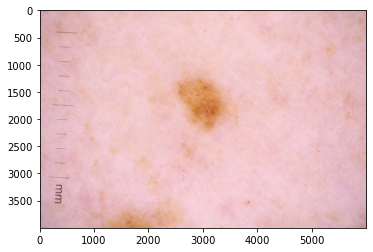

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_5681301.jpg


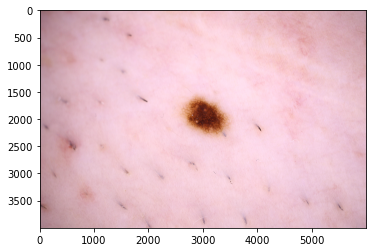

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_6864432.jpg


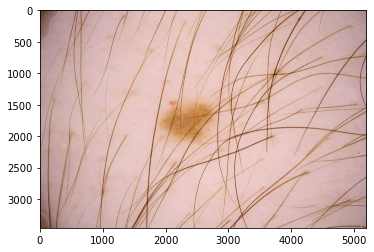

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_6682047.jpg


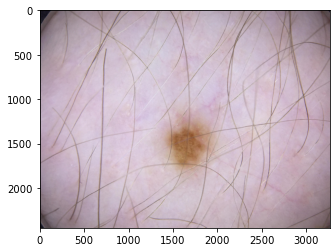

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_9272530.jpg


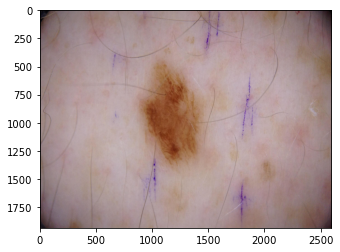

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_4749286.jpg


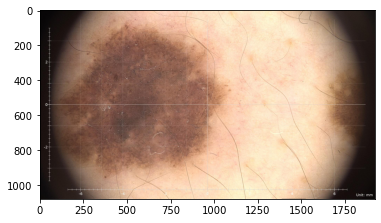

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_9317637.jpg


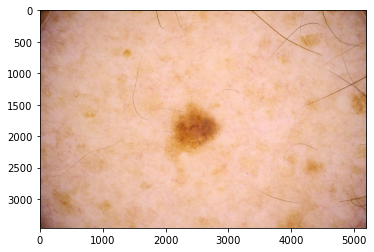

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_5239126.jpg


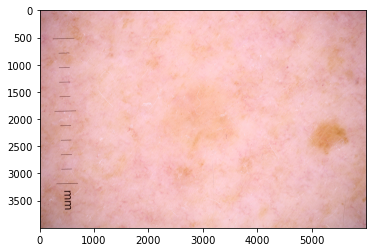

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_2522121.jpg


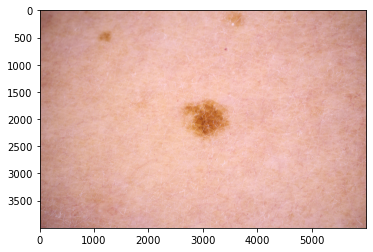

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_5643748.jpg


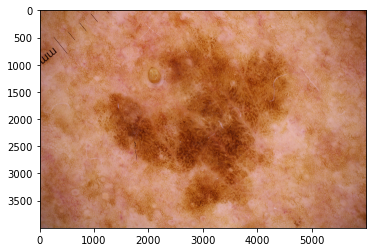

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_3469005.jpg


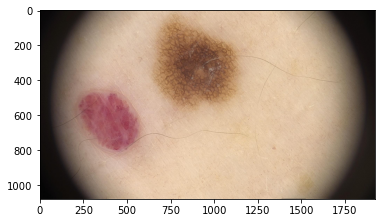

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_5100308.jpg


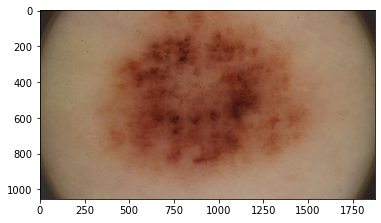

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_1406000.jpg


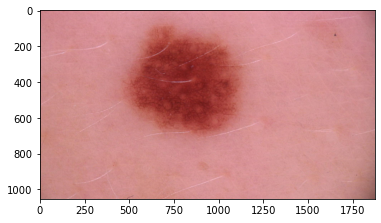

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_5210811.jpg


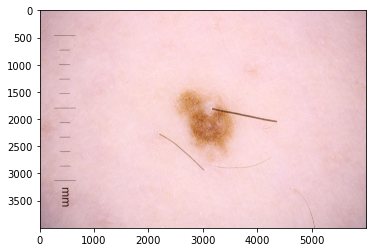

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_4327964.jpg


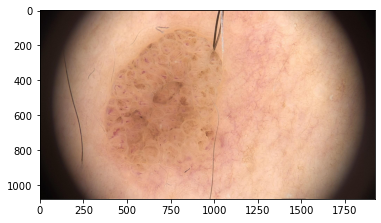

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_7026787.jpg


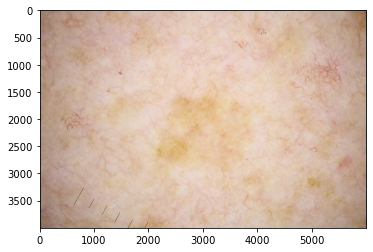

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_4374956.jpg


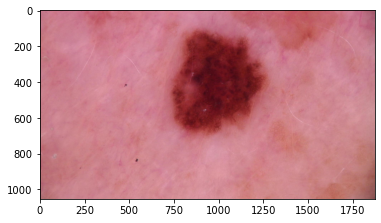

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_6429806.jpg


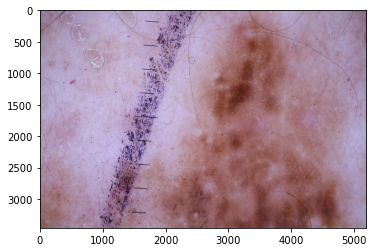

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_4449076.jpg


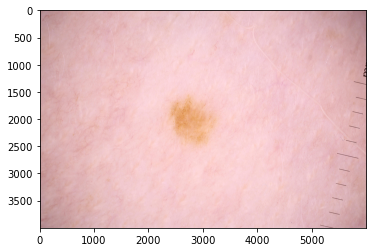

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_3963758.jpg


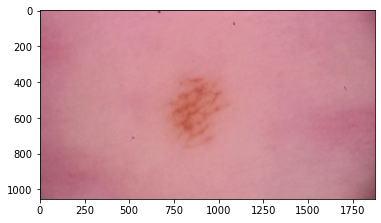

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_2600298.jpg


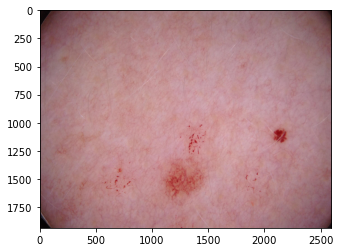

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_3464219.jpg


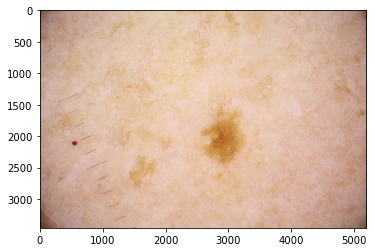

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_1492334.jpg


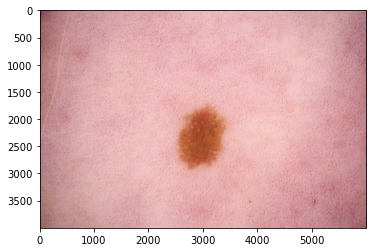

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_9813215.jpg


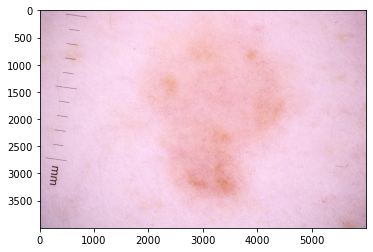

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_7811647.jpg


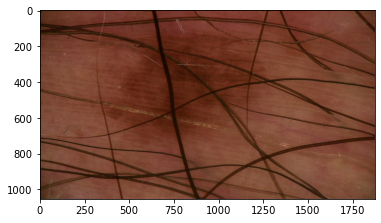

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_5375464.jpg


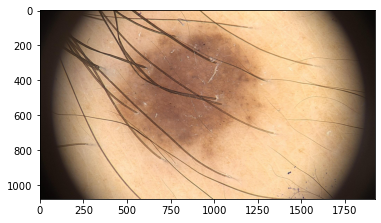

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_5701862.jpg


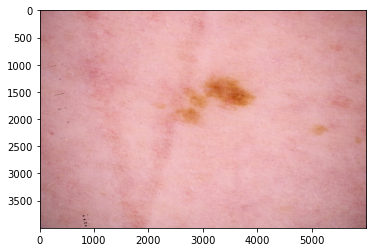

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_1925361.jpg


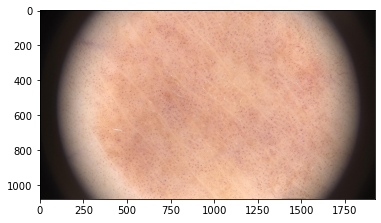

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_0477217.jpg


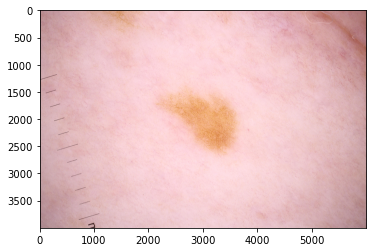

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_7812392.jpg


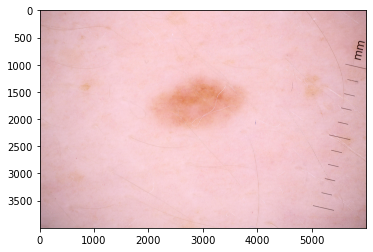

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_4308121.jpg


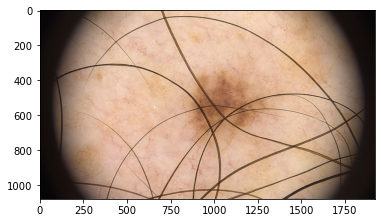

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_3784911.jpg


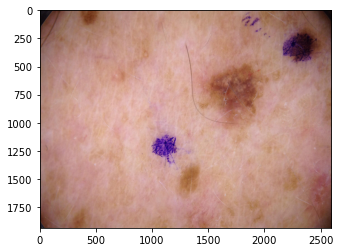

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_9951257.jpg


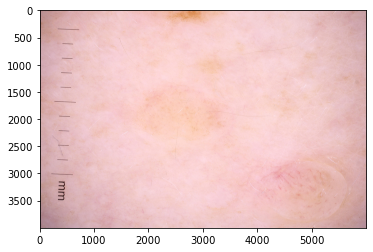

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_1292306.jpg


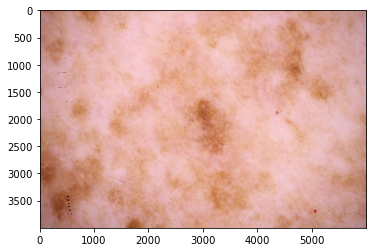

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_8443990.jpg


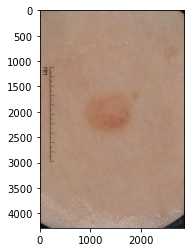

../input/siim-isic-melanoma-classification//jpeg/test/ISIC_6901140.jpg


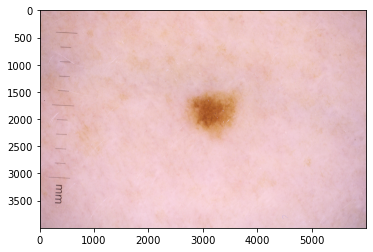

In [64]:
fnms = np.random.choice(dftst.im_pth, 50, replace=False)
for fnm in fnms:
    print(fnm)
    img = plt.imread(fnm)
    plt.imshow(img)
    plt.show()